<a href="https://colab.research.google.com/github/amitheb/Amitheb21/blob/main/NewCopy_of_Detectron_and_LayoutLM.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!pip install opencv-python-headless==4.1.2.30

     |████████████████████████████████| 21.8 MB 1.2 MB/s 


In [ ]:
!pip install torch torchvision torchaudio
!pip install zbar-py
!sudo apt-get install libzbar0
!pip install pyzbar
!pip install easyocr
!pip install imutils

     |████████████████████████████████| 543 kB 19.2 MB/s 
  Created wheel for zbar-py: filename=zbar_py-1.0.4-cp37-cp37m-linux_x86_64.whl size=201304 sha256=cacbcb6bb677bbf395467d75942100b3ac755213ee07b098d408a26bc150069b
  Stored in directory: /root/.cache/pip/wheels/87/19/bc/ae6963a059ba9263ed246bb6aac6328affc4936b81d9fd62a6
Successfully built zbar-py
Reading package lists... Done
Building dependency tree       
Reading state information... Done
The following additional packages will be installed:
  libv4l-0 libv4lconvert0
The following NEW packages will be installed:
  libv4l-0 libv4lconvert0 libzbar0
0 upgraded, 3 newly installed, 0 to remove and 39 not upgraded.
Need to get 193 kB of archives.
After this operation, 760 kB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu bionic/main amd64 libv4lconvert0 amd64 1.14.2-1 [76.1 kB]
Get:2 http://archive.ubuntu.com/ubuntu bionic/main amd64 libv4l-0 amd64 1.14.2-1 [41.7 kB]
Get:3 http://archive.ubuntu.com/ubun

In [ ]:
!pip install pyyaml==5.1

import torch
TORCH_VERSION = ".".join(torch.__version__.split(".")[:2])
CUDA_VERSION = torch.__version__.split("+")[-1]
print("torch: ", TORCH_VERSION, "; cuda: ", CUDA_VERSION)
# Install detectron2 that matches the above pytorch version
# See https://detectron2.readthedocs.io/tutorials/install.html for instructions
!pip install detectron2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/$CUDA_VERSION/torch$TORCH_VERSION/index.html
# If there is not yet a detectron2 release that matches the given torch + CUDA version, you need to install a different pytorch.

# exit(0)  # After installation, you may need to "restart runtime" in Colab. This line can also restart runtime

     |████████████████████████████████| 274 kB 5.0 MB/s 
  Created wheel for pyyaml: filename=PyYAML-5.1-cp37-cp37m-linux_x86_64.whl size=44092 sha256=c17779763054f8ee4ce116100f0a288add955220afab01c550fadc49d280faa0
  Stored in directory: /root/.cache/pip/wheels/77/f5/10/d00a2bd30928b972790053b5de0c703ca87324f3fead0f2fd9
Successfully built pyyaml
  Attempting uninstall: pyyaml
    Found existing installation: PyYAML 3.13
    Uninstalling PyYAML-3.13:
      Successfully uninstalled PyYAML-3.13
torch:  1.10 ; cuda:  cu111
Looking in links: https://dl.fbaipublicfiles.com/detectron2/wheels/cu111/torch1.10/index.html
     |████████████████████████████████| 7.0 MB 882 kB/s 
     |████████████████████████████████| 50 kB 2.9 MB/s 
     |████████████████████████████████| 145 kB 10.6 MB/s 
     |████████████████████████████████| 74 kB 3.3 MB/s 
     |████████████████████████████████| 130 kB 45.5 MB/s 
     |████████████████████████████████| 749 kB 43.1 MB/s 
     |███████████████████████████████

In [ ]:
# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import os, json, cv2, random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog

In [ ]:
from detectron2.data.datasets import register_coco_instances
register_coco_instances("experiment_21", {}, "/content/drive/MyDrive/labelcoco.json", "/content/drive/MyDrive/train")

In [ ]:
sample_metadata = MetadataCatalog.get("experiment_21")
dataset_dicts = DatasetCatalog.get("experiment_21")

[03/08 12:00:45 d2.data.datasets.coco]: Loaded 73 images in COCO format from /content/drive/MyDrive/labelcoco.json


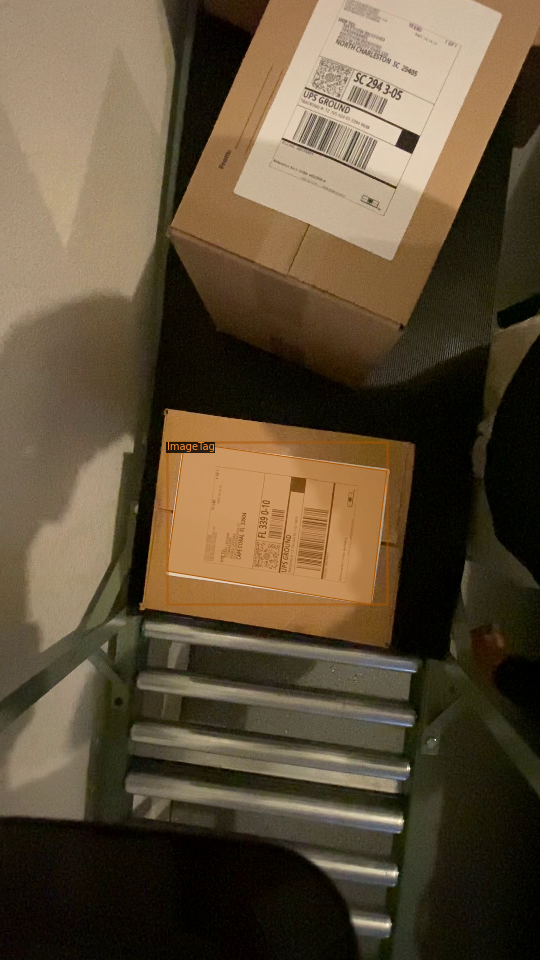

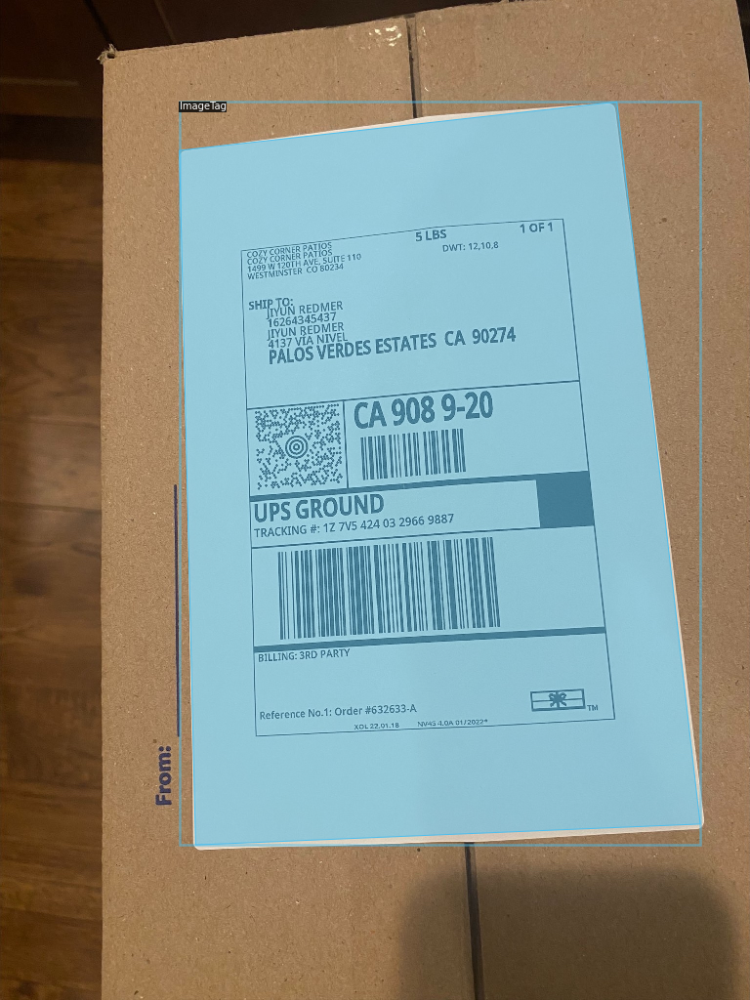

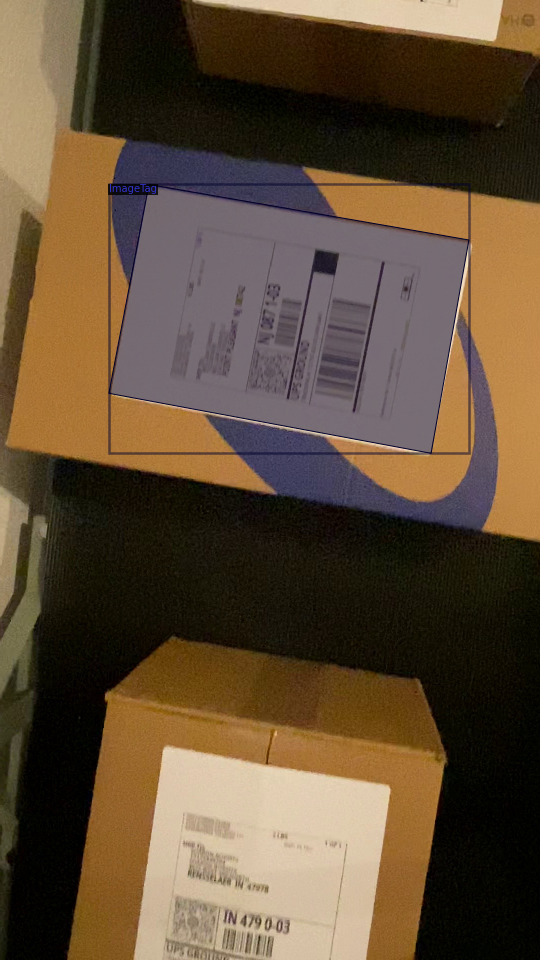

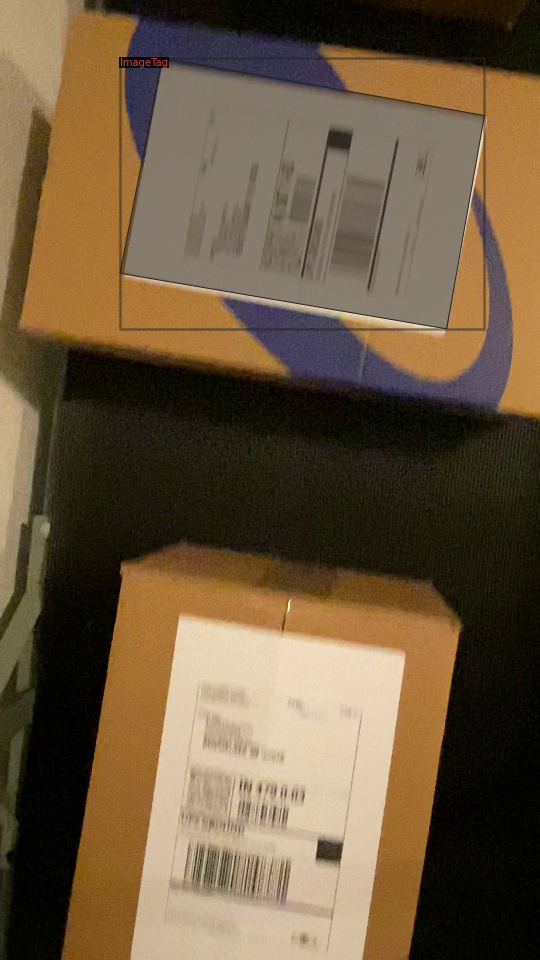

In [ ]:
import random

for d in random.sample(dataset_dicts, 4):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=sample_metadata, scale=0.5)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])

In [ ]:
!git clone https://github.com/facebookresearch/detectron2 detectron2_repo

fatal: destination path 'detectron2_repo' already exists and is not an empty directory.


In [ ]:
from detectron2.engine import DefaultTrainer
from detectron2.config import get_cfg
import os

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("experiment_21",)
cfg.DATASETS.TEST = ()   # no metrics implemented for this dataset
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml")# initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.02
cfg.SOLVER.MAX_ITER = 200   # 300 iterations seems good enough, but you can certainly train longer
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 128   # faster, and good enough for this toy dataset
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1  # 3 classes (Person, Helmet, Car)

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg)
trainer.resume_or_load(resume=True)
trainer.train()

[03/08 12:01:13 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

model_final_280758.pkl: 167MB [00:03, 49.4MB/s]                           
Skip loading parameter 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (81, 1024) in the checkpoint but (2, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (2,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.weight' to the model due to incompatible shapes: (320, 1024) in the checkpoint but (4, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.bias' to the model due to incompatible shapes: (320,) in the checkpoint but (4,) in the model! You might want to double check if this is expected.
Some model parameters or buffers are not found in the checkpoint:
roi_heads.box_pre

[03/08 12:01:22 d2.engine.train_loop]: Starting training from iteration 0


/usr/local/lib/python3.7/dist-packages/detectron2/structures/image_list.py:88: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  max_size = (max_size + (stride - 1)) // stride * stride
/usr/local/lib/python3.7/dist-packages/torch/functional.py:445: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at  ../aten/src/ATen/native/TensorShape.cpp:2157.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


[03/08 12:01:52 d2.utils.events]:  eta: 0:04:24  iter: 19  total_loss: 0.7977  loss_cls: 0.319  loss_box_reg: 0.5272  loss_rpn_cls: 0.006977  loss_rpn_loc: 0.006593  time: 1.4220  data_time: 0.0485  lr: 0.0019181  max_mem: 2639M
[03/08 12:02:20 d2.utils.events]:  eta: 0:03:50  iter: 39  total_loss: 0.3654  loss_cls: 0.08454  loss_box_reg: 0.2569  loss_rpn_cls: 0.006201  loss_rpn_loc: 0.004328  time: 1.4166  data_time: 0.0104  lr: 0.0039161  max_mem: 2639M
[03/08 12:02:48 d2.utils.events]:  eta: 0:03:21  iter: 59  total_loss: 0.2085  loss_cls: 0.05123  loss_box_reg: 0.1464  loss_rpn_cls: 0.000653  loss_rpn_loc: 0.005276  time: 1.4067  data_time: 0.0075  lr: 0.0059141  max_mem: 2727M
[03/08 12:03:17 d2.utils.events]:  eta: 0:02:58  iter: 79  total_loss: 0.1841  loss_cls: 0.03865  loss_box_reg: 0.1379  loss_rpn_cls: 0.0004456  loss_rpn_loc: 0.002815  time: 1.4201  data_time: 0.0072  lr: 0.0079121  max_mem: 2727M
[03/08 12:03:46 d2.utils.events]:  eta: 0:02:29  iter: 99  total_loss: 0.2378

In [ ]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir output

In [ ]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5   # set the testing threshold for this model
cfg.DATASETS.TEST = ("experiment_21",)
predictor = DefaultPredictor(cfg)

/content/drive/MyDrive/train/Images17.jpg


/usr/local/lib/python3.7/dist-packages/detectron2/structures/image_list.py:88: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  max_size = (max_size + (stride - 1)) // stride * stride


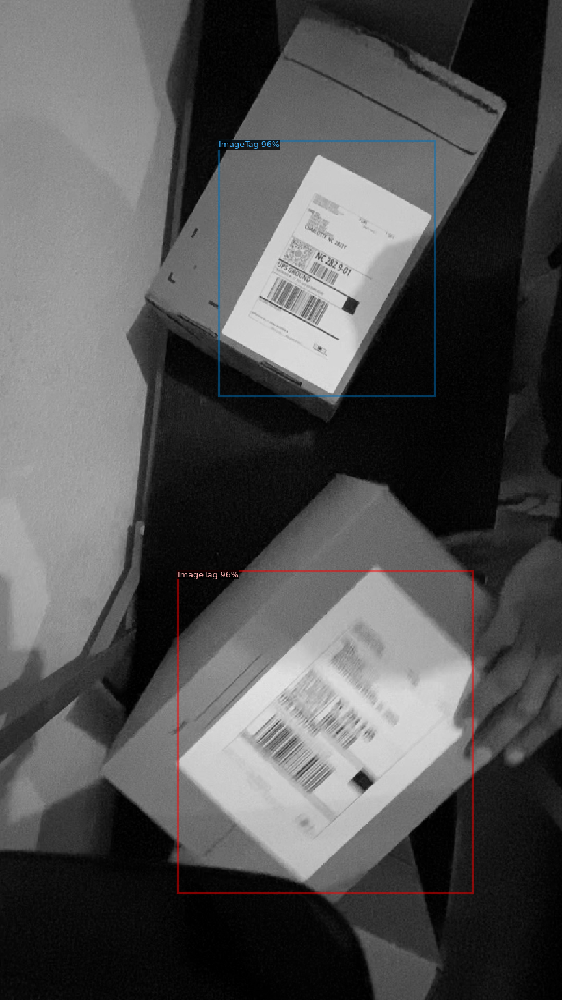

/content/drive/MyDrive/train/Images30.jpg


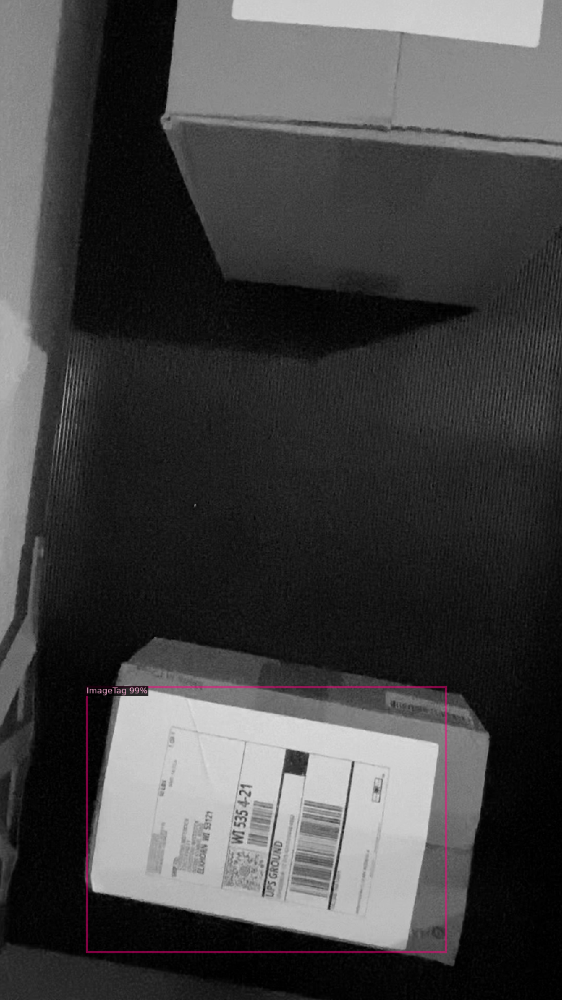

/content/drive/MyDrive/train/Images47.jpg


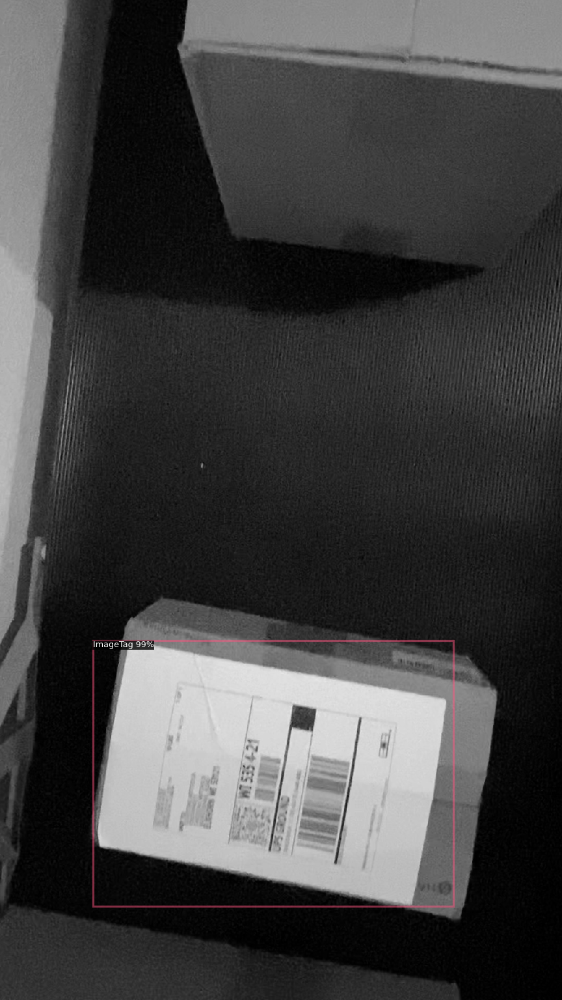

/content/drive/MyDrive/train/Images18.jpg


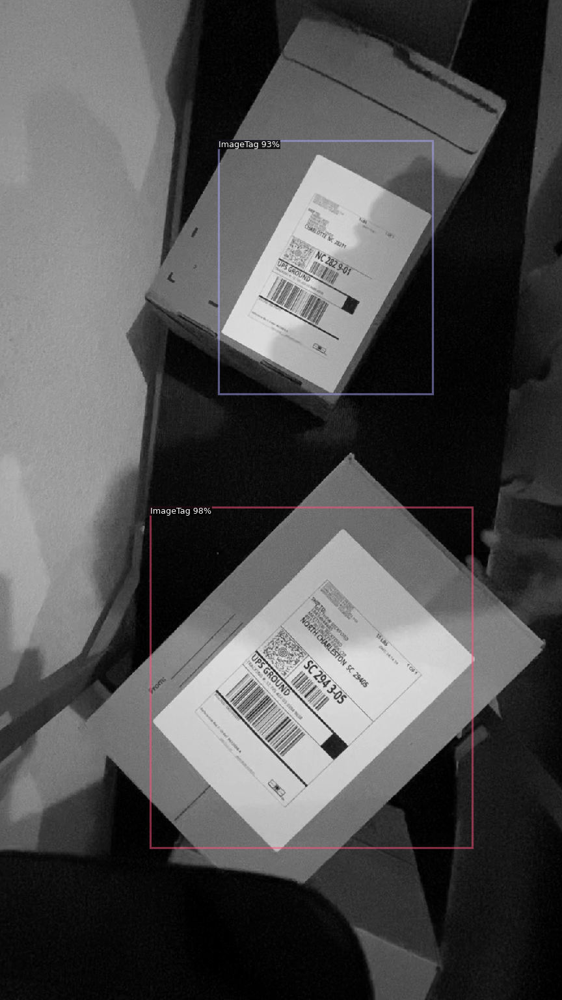

/content/drive/MyDrive/train/Images31.jpg


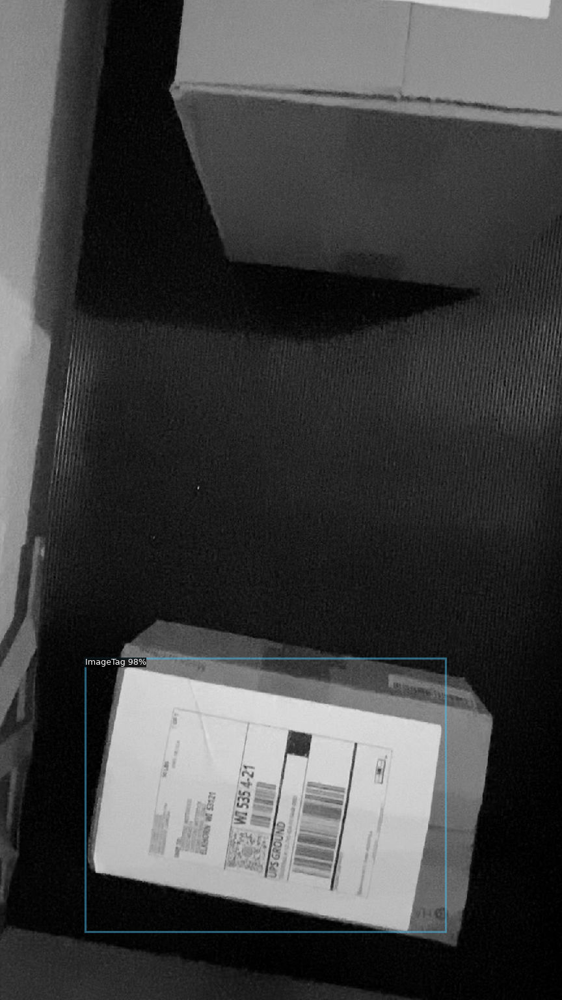

/content/drive/MyDrive/train/Images60.jpg


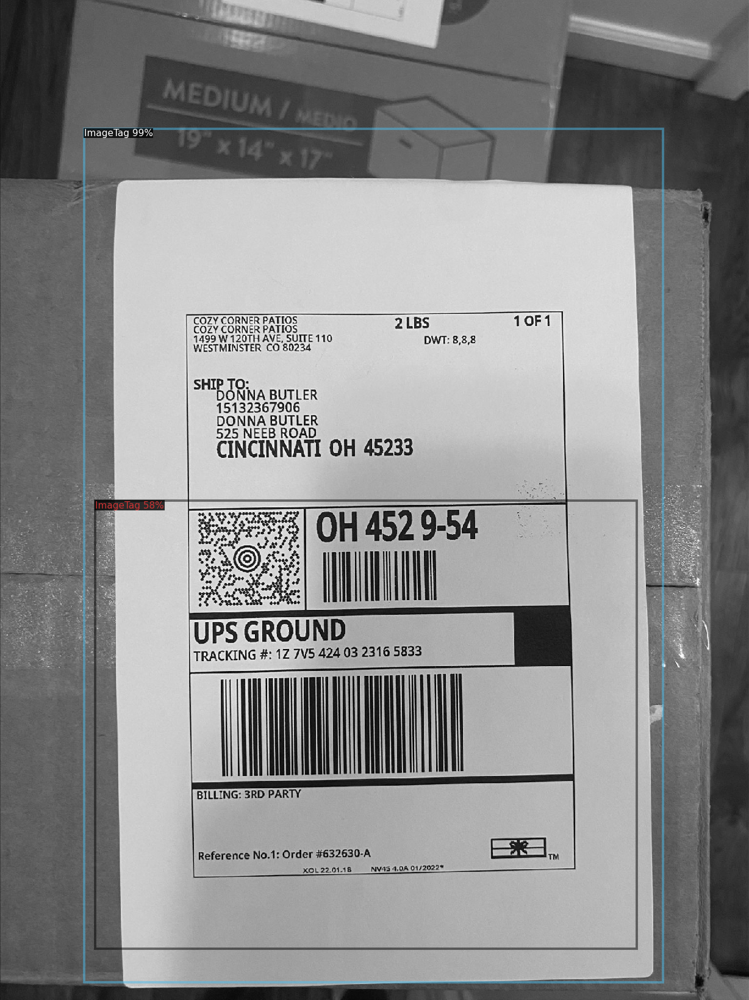

/content/drive/MyDrive/train/Images36.jpg


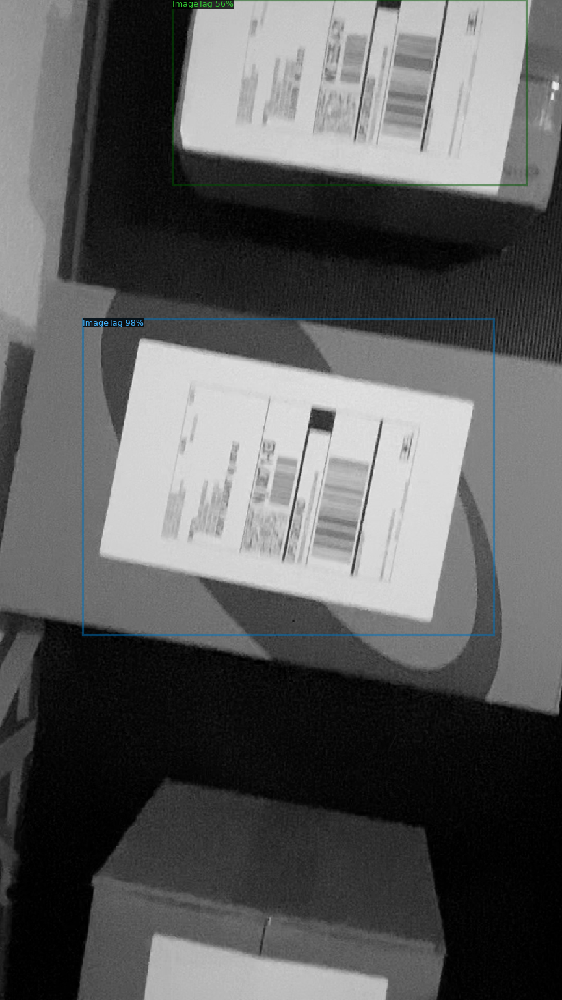

/content/drive/MyDrive/train/Images65.jpg


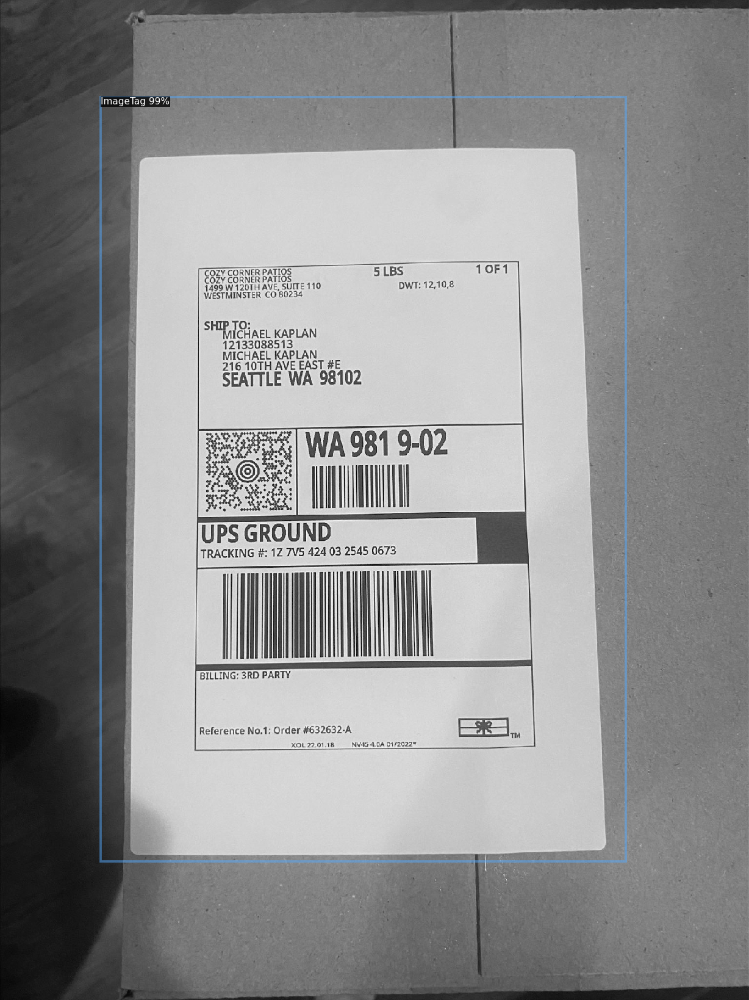

In [ ]:
from detectron2.utils.visualizer import ColorMode

for d in random.sample(dataset_dicts, 8):
    print(d["file_name"])    
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)
    v = Visualizer(im[:, :, ::-1],
                   metadata=sample_metadata, 
                   scale=0.8, 
                   instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels
    )
    v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(v.get_image()[:, :, ::-1])

In [ ]:
print(outputs)

{'instances': Instances(num_instances=1, image_height=1920, image_width=1080, fields=[pred_boxes: Boxes(tensor([[ 198.8697, 1112.4843,  838.7264, 1621.0315]], device='cuda:0')), scores: tensor([0.9973], device='cuda:0'), pred_classes: tensor([0], device='cuda:0')])}


In [ ]:
croped = outputs['instances'][outputs['instances'].pred_classes==0].pred_boxes.tensor.cpu().numpy()

In [ ]:
print(croped)

[[ 206.7941   198.94278 1281.8894  1763.947  ]]


In [ ]:
im=cv2.imread("/content/drive/MyDrive/train/Images68.jpg")
outputs=predictor(im)
print(outputs)
cv2_imshow(im)

In [ ]:
im.shape

(1112, 1332, 3)

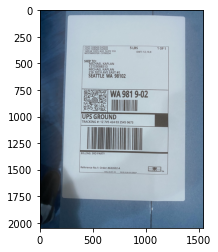

In [ ]:
import cv2
import matplotlib.pyplot as plt
image = cv2.imread("/content/drive/MyDrive/train/Images68.jpg")
plt.imshow(image)

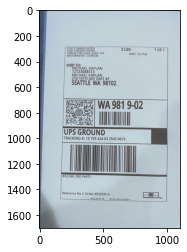

In [ ]:
new_image2 = image[50:1750,200:1300]
plt.imshow(new_image2)

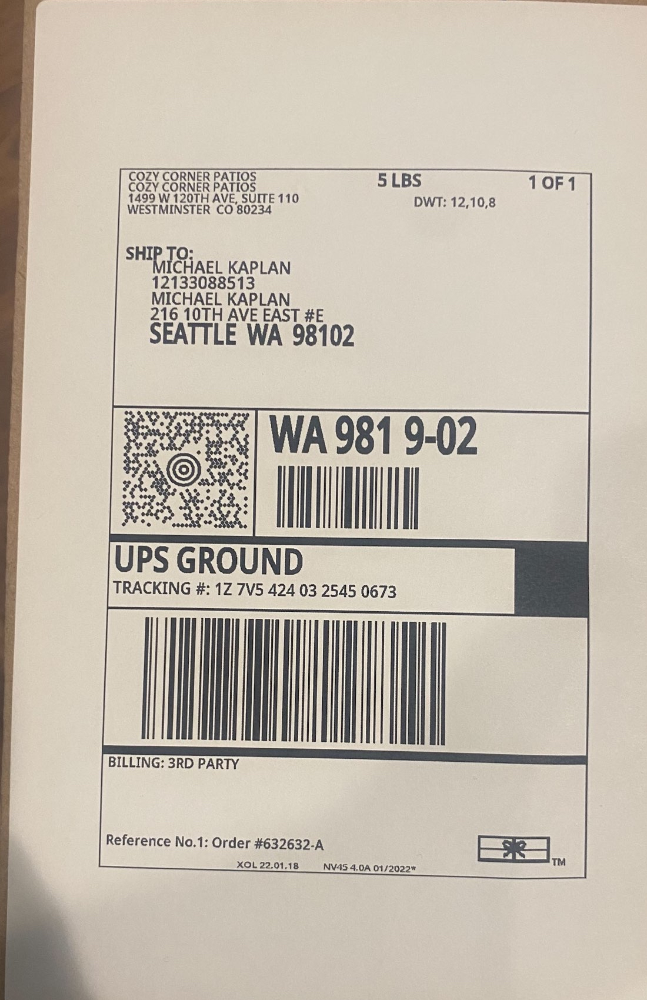

In [ ]:
new_image = cv2_imshow(new_image2)

In [ ]:
from PIL import Image

In [ ]:
def make_bb(image,bb):
  image=image[int(bb[0]):int(bb[2]),int(bb[1]):int(bb[3])]
  return image

In [ ]:
print(int(croped[0][0]))

295


In [ ]:
im=make_bb(im,croped[0])
cv2_imshow(im)

In [ ]:
outputs["instances"][0]

Instances(num_instances=1, image_height=2048, image_width=1536, fields=[pred_boxes: Boxes(tensor([[ 295.4854,  204.2098, 1407.5292, 1666.4663]], device='cuda:0')), scores: tensor([0.9628], device='cuda:0'), pred_classes: tensor([0], device='cuda:0')])

In [ ]:
# Download Config File
f= open("config.yaml","w")
f.write(cfg.dump())
f.close()

In [ ]:
!pip install -q transformers seqeval

     |████████████████████████████████| 3.8 MB 34.0 MB/s 
     |████████████████████████████████| 43 kB 2.3 MB/s 
     |████████████████████████████████| 67 kB 5.9 MB/s 
     |████████████████████████████████| 895 kB 62.3 MB/s 
     |████████████████████████████████| 6.5 MB 58.6 MB/s 


In [ ]:
from PIL import Image, ImageDraw, ImageFont

image = Image.open("/content/drive/MyDrive/dataset/train/images/Image11.jpg_image_0.jpg")
image = image.convert("RGB")
image

In [ ]:
import json

with open('/content/drive/MyDrive/dataset/train/annotations/Image11.json', encoding='utf-8-sig') as f:
    data = json.load(f)

words = []
bounding_boxes = []
labels = []
for annotation in data[0]['form']:
  # get label
  label = annotation['label']
  # get words
  for annotated_word in annotation['words']:
      if annotated_word['text'] == '':
        continue
      words.append(annotated_word['text'])
      bounding_boxes.append(annotated_word['box'])
      labels.append(label)

print("Words:", words)
print("Bounding boxes:", bounding_boxes)
print("Labels:", labels)


Words: ['COZY', 'CORNER', 'PATIOS', 'COZY', 'CORNER', 'PATIOS', '1499', 'W', '120TH', 'AVE,', 'SUITE', '110', 'WESTMINSTER', 'CO 80234', 'DONNA', 'BUTLER', '15132367906', 'DONNA', 'BUTLER', '525', 'NEEB', 'ROAD', 'CINCINNATI', 'OH', '45233', 'OH', '452', '9-54', 'UPS', 'GROUND', 'TRACKING', '#:', '1Z 7V5', '424 03 2316 5833', 'Reference', 'No.', '1:', 'Order', '#632630-A']
Bounding boxes: [[169, 270, 225, 291], [227, 270, 313, 292], [315, 270, 391, 291], [170, 289, 225, 309], [228, 289, 312, 309], [315, 288, 392, 309], [171, 308, 220, 328], [222, 308, 245, 327], [248, 308, 311, 327], [314, 307, 361, 329], [364, 308, 424, 328], [426, 309, 464, 329], [169, 325, 316, 348], [322, 326, 418, 347], [217, 420, 324, 448], [329, 420, 433, 448], [217, 446, 398, 474], [218, 474, 325, 500], [331, 474, 434, 501], [217, 501, 266, 527], [274, 501, 345, 526], [352, 500, 432, 527], [215, 526, 443, 567], [456, 526, 514, 567], [527, 526, 635, 568], [432, 679, 520, 745], [532, 677, 639, 744], [646, 675, 76

In [ ]:
image.size

(1122, 1666)

In [ ]:
assert len(words) == len(bounding_boxes) == len(labels)
print(len(words))

39


In [ ]:
image_with_bboxes = image.copy()

draw = ImageDraw.Draw(image_with_bboxes, "RGBA")
for bbox in bounding_boxes:
    draw.rectangle(bbox, outline='red', width=1)

image_with_bboxes

Let's visualize the bounding boxes (we use a single color for all labels for now):

Future to do: sort the words/bounding boxes/labels from top left in the document to bottom right. We can do this based on the coordinates of the bounding boxes. Checking the FUNSD paper, the bounding boxes are in = [xleft, ytop, xright, ybottom] format.

Resize image + bounding boxes
Next, we resize the image to 224x224 in order to provide it to a pre-trained backbone CNN (we'll use ResNet-101 pre-trained on ImageNet, available in torchvision). We have to resize the bounding boxes accordingly.

Source: https://stackoverflow.com/questions/61315541/resnet-101-featuremap-shape

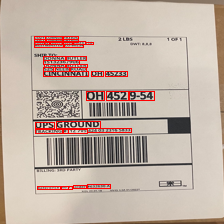

In [ ]:
from PIL import Image
import numpy as np

# resize image
target_size = 224
resized_image = image.copy().resize((target_size, target_size))

# resize corresponding bounding boxes (annotations)
# Thanks, Stackoverflow: https://stackoverflow.com/questions/49466033/resizing-image-and-its-bounding-box
def resize_bounding_box(bbox, original_image, target_size):
  x_, y_ = original_image.size

  x_scale = target_size / x_ 
  y_scale = target_size / y_
  
  origLeft, origTop, origRight, origBottom = tuple(bbox)
  
  x = int(np.round(origLeft * x_scale))
  y = int(np.round(origTop * y_scale))
  xmax = int(np.round(origRight * x_scale))
  ymax = int(np.round(origBottom * y_scale))
  
  return [x, y, xmax, ymax]

resized_bounding_boxes = [resize_bounding_box(bbox, image, target_size) for bbox in bounding_boxes]

draw = ImageDraw.Draw(resized_image, "RGBA")
for bbox in resized_bounding_boxes:
    draw.rectangle(bbox, outline='red', width=1)

resized_image

In [ ]:
from torchvision.transforms import ToTensor

image = ToTensor()(resized_image).unsqueeze(0) # batch size of 1
image.shape

torch.Size([1, 3, 224, 224])

In [ ]:
import torch
import torchvision
from torchvision.transforms import ToTensor

# load resnet101 model and remove the last layer
model = torchvision.models.resnet101(pretrained=True)
model = torch.nn.Sequential(*(list(model.children())[:-3]))

with torch.no_grad():
    feature_map = model(image)

print(feature_map.size())  # torch.Size([1, 1024, 14, 14])

Downloading: "https://download.pytorch.org/models/resnet101-63fe2227.pth" to /root/.cache/torch/hub/checkpoints/resnet101-63fe2227.pth


  0%|          | 0.00/171M [00:00<?, ?B/s]

torch.Size([1, 1024, 14, 14])


Use ROI-align for bounding boxes
Next, we use ROI-align to get feature maps for each individual resized bounding box.

In order to understand ROI-align, I highly recommend this video which helped me a lot!

Also, this Stackoverflow post helped me a lot in understanding how this is implemented in PyTorch.

In [ ]:
import torch
from torchvision.ops import RoIAlign

output_size = (3,3)
spatial_scale = feature_map.shape[2]/target_size # 14/224
sampling_ratio = 2  

roi_align = RoIAlign(output_size, spatial_scale=spatial_scale, sampling_ratio=sampling_ratio)

def align_bounding_boxes(bounding_boxes):
    aligned_bounding_boxes = []
    for bbox in bounding_boxes:
        aligned_bbox = [bbox[0] - 0.5, bbox[1] - 0.5, bbox[2] + 0.5, bbox[3] + 0.5]
        aligned_bounding_boxes.append(aligned_bbox)

    return aligned_bounding_boxes

feature_maps_bboxes = roi_align(input=feature_map, 
                                # we pass in a single tensor, with each bounding box also containing the batch index (0)
                                # We also add -0.5 for the first two coordinates and +0.5 for the last two coordinates,
                                # see https://stackoverflow.com/questions/60060016/why-does-roi-align-not-seem-to-work-in-pytorch
                                rois=torch.tensor([[0] + bbox for bbox in align_bounding_boxes(resized_bounding_boxes)]).float()
                      )
print(feature_maps_bboxes.shape)

torch.Size([39, 1024, 3, 3])


In [ ]:
visual_embeddings = torch.flatten(feature_maps_bboxes, 1)
visual_embeddings.shape

torch.Size([39, 9216])

In [ ]:
import torch.nn as nn

projection = nn.Linear(in_features=visual_embeddings.shape[-1], out_features=768)
output = projection(visual_embeddings)
print(output.shape)

torch.Size([39, 768])


## Define PyTorch dataset and dataloaders

Now that we have shown how this works for a single document, let's define a PyTorch dataset and dataloaders.

Let's first create 2 lists: image files names for training and testing.


In [ ]:
from os import listdir

# list all training image file names
image_files_train = [f for f in listdir('/content/drive/MyDrive/dataset/train/images')]
# list all test image file names
image_files_test = [f for f in listdir('/content/drive/MyDrive/dataset/test/images')]

In [ ]:
labels = ['B-ADDRESS','B-DETAILS','B-NAME','B-REF.NO','B-SHIPFROM','B-ZIPCODE','E-ADDRESS',
          'E-DETAILS','E-NAME','E-REF.NO','E-SHIPFROM','E-ZIPCODE','I-ADDRESS','I-DETAILS',
          'I-NAME','I-REF.NO','I-SHIPFROM','I-ZIPCODE','O','S-ADDRESS','S-DETAILS','S-NAME',
          'S-REF.NO','S-SHIPFROM','S-ZIPCODE']
labels

['B-ADDRESS',
 'B-DETAILS',
 'B-NAME',
 'B-REF.NO',
 'B-SHIPFROM',
 'B-ZIPCODE',
 'E-ADDRESS',
 'E-DETAILS',
 'E-NAME',
 'E-REF.NO',
 'E-SHIPFROM',
 'E-ZIPCODE',
 'I-ADDRESS',
 'I-DETAILS',
 'I-NAME',
 'I-REF.NO',
 'I-SHIPFROM',
 'I-ZIPCODE',
 'O',
 'S-ADDRESS',
 'S-DETAILS',
 'S-NAME',
 'S-REF.NO',
 'S-SHIPFROM',
 'S-ZIPCODE']

In [ ]:
idx2label = {v: k for v, k in enumerate(labels)}
label2idx = {k: v for v, k in enumerate(labels)}
label2idx

{'B-ADDRESS': 0,
 'B-DETAILS': 1,
 'B-NAME': 2,
 'B-REF.NO': 3,
 'B-SHIPFROM': 4,
 'B-ZIPCODE': 5,
 'E-ADDRESS': 6,
 'E-DETAILS': 7,
 'E-NAME': 8,
 'E-REF.NO': 9,
 'E-SHIPFROM': 10,
 'E-ZIPCODE': 11,
 'I-ADDRESS': 12,
 'I-DETAILS': 13,
 'I-NAME': 14,
 'I-REF.NO': 15,
 'I-SHIPFROM': 16,
 'I-ZIPCODE': 17,
 'O': 18,
 'S-ADDRESS': 19,
 'S-DETAILS': 20,
 'S-NAME': 21,
 'S-REF.NO': 22,
 'S-SHIPFROM': 23,
 'S-ZIPCODE': 24}

In [ ]:
len(image_files_test)

4

Now let's define the PyTorch dataset:

In [ ]:
from torch.utils.data import Dataset, DataLoader
from PIL import Image
import json
import numpy as np
from torchvision.transforms import ToTensor
import torch

def normalize_box(box, width, height):
     return [
         int(1000 * (box[0] / width)),
         int(1000 * (box[1] / height)),
         int(1000 * (box[2] / width)),
         int(1000 * (box[3] / height)),
     ]

# resize corresponding bounding boxes (annotations)
# Thanks, Stackoverflow: https://stackoverflow.com/questions/49466033/resizing-image-and-its-bounding-box
def resize_and_align_bounding_box(bbox, original_image, target_size):
  x_, y_ = original_image.size

  x_scale = target_size / x_ 
  y_scale = target_size / y_
  
  origLeft, origTop, origRight, origBottom = tuple(bbox)
  
  x = int(np.round(origLeft * x_scale))
  y = int(np.round(origTop * y_scale))
  xmax = int(np.round(origRight * x_scale))
  ymax = int(np.round(origBottom * y_scale)) 
  
  return [x-0.5, y-0.5, xmax+0.5, ymax+0.5]

class FUNSDDataset(Dataset):
    """LayoutLM dataset with visual features."""

    def __init__(self, image_file_names, tokenizer, max_length, target_size, train=True):
        self.image_file_names = image_file_names
        self.tokenizer = tokenizer
        self.max_seq_length = max_length
        self.target_size = target_size
        self.pad_token_box = [0, 0, 0, 0]
        self.train = train

    def __len__(self):
        return len(self.image_file_names)

    def __getitem__(self, idx):

        # first, take an image
        item = self.image_file_names[idx]
        print(item)
        if self.train:
          base_path = "/content/drive/MyDrive/dataset/train"
        else:
          base_path = "/content/drive/MyDrive/dataset/test"
        
        original_image = Image.open(base_path + "/images/" + item).convert("RGB")
        # resize to target size (to be provided to the pre-trained backbone)
        resized_image = original_image.resize((self.target_size, self.target_size))
        
        # first, read in annotations at word-level (words, bounding boxes, labels)
        with open(base_path + '/annotations/' + item[:-16] + '.json') as f:
          data = json.load(f)
        words = []
        unnormalized_word_boxes = []
        word_labels = []
        for annotation in data[0]['form']:
          # get label
          label = annotation['label']
          # get words
          for annotated_word in annotation['words']:
              if annotated_word['text'] == '':
                continue
              words.append(annotated_word['text'])
              unnormalized_word_boxes.append(annotated_word['box'])
              word_labels.append(label)

        width, height = original_image.size
        normalized_word_boxes = [normalize_box(bbox, width, height) for bbox in unnormalized_word_boxes]
        assert len(words) == len(normalized_word_boxes)

        # next, transform to token-level (input_ids, attention_mask, token_type_ids, bbox, labels)
        token_boxes = []
        unnormalized_token_boxes = []
        token_labels = []
        for word, unnormalized_box, box, label in zip(words, unnormalized_word_boxes, normalized_word_boxes, word_labels):
            word_tokens = self.tokenizer.tokenize(word)
            unnormalized_token_boxes.extend(unnormalized_box for _ in range(len(word_tokens)))
            token_boxes.extend(box for _ in range(len(word_tokens)))
            # label first token as B-label (beginning), label all remaining tokens as I-label (inside)
            for i in range(len(word_tokens)):
              if i == 0:
                token_labels.extend(['B-' + label])
              else:
                token_labels.extend(['I-' + label])
        
        # Truncation of token_boxes + token_labels
        special_tokens_count = 2 
        if len(token_boxes) > self.max_seq_length - special_tokens_count:
            token_boxes = token_boxes[: (self.max_seq_length - special_tokens_count)]
            unnormalized_token_boxes = unnormalized_token_boxes[: (self.max_seq_length - special_tokens_count)]
            token_labels = token_labels[: (self.max_seq_length - special_tokens_count)]
        
        # add bounding boxes and labels of cls + sep tokens
        token_boxes = [[0, 0, 0, 0]] + token_boxes + [[1000, 1000, 1000, 1000]]
        unnormalized_token_boxes = [[0, 0, 0, 0]] + unnormalized_token_boxes + [[1000, 1000, 1000, 1000]]
        token_labels = [-100] + token_labels + [-100]
        
        encoding = self.tokenizer(' '.join(words), padding='max_length', truncation=True)
        # Padding of token_boxes up the bounding boxes to the sequence length.
        input_ids = self.tokenizer(' '.join(words), truncation=True)["input_ids"]
        padding_length = self.max_seq_length - len(input_ids)
        token_boxes += [self.pad_token_box] * padding_length
        unnormalized_token_boxes += [self.pad_token_box] * padding_length
        token_labels += [-100] * padding_length
        encoding['bbox'] = token_boxes
        encoding['labels'] = token_labels

        assert len(encoding['input_ids']) == self.max_seq_length
        assert len(encoding['attention_mask']) == self.max_seq_length
        assert len(encoding['token_type_ids']) == self.max_seq_length
        assert len(encoding['bbox']) == self.max_seq_length
        assert len(encoding['labels']) == self.max_seq_length

        encoding['resized_image'] = ToTensor()(resized_image)
        # rescale and align the bounding boxes to match the resized image size (typically 224x224) 
        encoding['resized_and_aligned_bounding_boxes'] = [resize_and_align_bounding_box(bbox, original_image, self.target_size) 
                                                          for bbox in unnormalized_token_boxes]

        encoding['unnormalized_token_boxes'] = unnormalized_token_boxes
        
        # finally, convert everything to PyTorch tensors 
        for k,v in encoding.items():
            if k == 'labels':
              label_indices = []
              # convert labels from string to indices
              for label in encoding[k]:
                if label != -100:
                  label_indices.append(label2idx[label])
                else:
                  label_indices.append(label)
              encoding[k] = label_indices
            encoding[k] = torch.as_tensor(encoding[k])
        
        return encoding

In [ ]:
from transformers import BertTokenizer

tokenizer = BertTokenizer.from_pretrained("bert-base-uncased")
train_dataset = FUNSDDataset(image_file_names=image_files_train, tokenizer=tokenizer, max_length=512, target_size=224)

Downloading:   0%|          | 0.00/226k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/28.0 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/570 [00:00<?, ?B/s]

Let's verify an example:

In [ ]:
encoding = train_dataset[0]
encoding.keys()

Image19.jpg_image_0.jpg


dict_keys(['input_ids', 'token_type_ids', 'attention_mask', 'bbox', 'labels', 'resized_image', 'resized_and_aligned_bounding_boxes', 'unnormalized_token_boxes'])

In [ ]:
tokenizer.decode(encoding.input_ids)

"[CLS] cozy corner patios cozy corner patios 1499 w 120th ave, suite 110 westminster co'80234 polina hristova 16266168340 polina hristova 704 north curtis avenue alhambra ca 91801 ca 901 9 - 13 ups ground tracking # : 12 7v5 424 03 2634 1780 reference no. 1 : order # 632503 - a [SEP] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [

In [ ]:
encoding['resized_image'].shape

torch.Size([3, 224, 224])

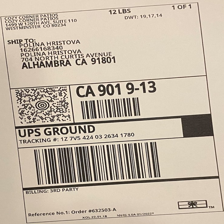

In [ ]:
from torchvision.transforms import ToPILImage

test_image = ToPILImage()(encoding['resized_image']).convert("RGB")
test_image

torch.Size([512, 4])


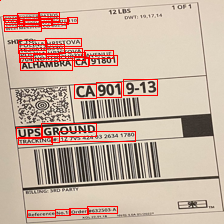

In [ ]:
draw = ImageDraw.Draw(test_image, "RGBA")
for bbox in encoding['resized_and_aligned_bounding_boxes'].tolist():
    draw.rectangle(bbox, outline='red', width=1)
    
print(encoding['resized_and_aligned_bounding_boxes'].shape)
test_image

In [ ]:
train_dataloader = DataLoader(train_dataset, batch_size=4)
batch = next(iter(train_dataloader))

Image19.jpg_image_0.jpg
Image14.jpg_image_0.jpg
Image07.jpg_image_0.jpg
Image04.jpg_image_0.jpg


In [ ]:
for k,v in batch.items():
  print(k, batch[k].shape)

input_ids torch.Size([4, 512])
token_type_ids torch.Size([4, 512])
attention_mask torch.Size([4, 512])
bbox torch.Size([4, 512, 4])
labels torch.Size([4, 512])
resized_image torch.Size([4, 3, 224, 224])
resized_and_aligned_bounding_boxes torch.Size([4, 512, 4])
unnormalized_token_boxes torch.Size([4, 512, 4])


In [ ]:
# this is how we can provide resized and aligned bounding boxes to the roi align (as a list of Tensors)
for i in batch['resized_and_aligned_bounding_boxes']:
  print(i.shape)

torch.Size([512, 4])
torch.Size([512, 4])
torch.Size([512, 4])
torch.Size([512, 4])


## Define model

So if we want to define a model that includes LayoutLM + the visual embeddings, it would look like this:

In [ ]:
import torch.nn as nn
from transformers.models.layoutlm import LayoutLMModel, LayoutLMConfig
from transformers.modeling_outputs import TokenClassifierOutput
import torchvision
from torchvision.ops import RoIAlign

class LayoutLMForTokenClassification(nn.Module):
    def __init__(self, output_size=(3,3), 
                 spatial_scale=14/224, 
                 sampling_ratio=2
        ): 
        super().__init__()
        
        # LayoutLM base model + token classifier
        self.num_labels = len(label2idx)
        self.layoutlm = LayoutLMModel.from_pretrained("microsoft/layoutlm-base-uncased", num_labels=self.num_labels)
        self.dropout = nn.Dropout(self.layoutlm.config.hidden_dropout_prob)
        self.classifier = nn.Linear(self.layoutlm.config.hidden_size, self.num_labels)

        # backbone + roi-align + projection layer
        model = torchvision.models.resnet101(pretrained=True)
        self.backbone = nn.Sequential(*(list(model.children())[:-3]))
        self.roi_align = RoIAlign(output_size, spatial_scale=spatial_scale, sampling_ratio=sampling_ratio)
        self.projection = nn.Linear(in_features=1024*3*3, out_features=self.layoutlm.config.hidden_size)

    def forward(
        self,
        input_ids,
        bbox,
        attention_mask,
        token_type_ids,
        position_ids=None,
        head_mask=None,
        inputs_embeds=None,
        labels=None,
        resized_images=None, # shape (N, C, H, W), with H = W = 224
        resized_and_aligned_bounding_boxes=None, # single torch tensor that also contains the batch index for every bbox at image size 224
        output_attentions=None,
        output_hidden_states=None,
        return_dict=None,
    ):
        r"""
        labels (:obj:`torch.LongTensor` of shape :obj:`(batch_size, sequence_length)`, `optional`):
            Labels for computing the token classification loss. Indices should be in ``[0, ..., config.num_labels -
            1]``.

        """
        return_dict = return_dict if return_dict is not None else self.layoutlm.config.use_return_dict

        # first, forward pass on LayoutLM
        outputs = self.layoutlm(
            input_ids=input_ids,
            bbox=bbox,
            attention_mask=attention_mask,
            token_type_ids=token_type_ids,
            position_ids=position_ids,
            head_mask=head_mask,
            inputs_embeds=inputs_embeds,
            output_attentions=output_attentions,
            output_hidden_states=output_hidden_states,
            return_dict=return_dict,
        )

        sequence_output = outputs[0]

        # next, send resized images of shape (batch_size, 3, 224, 224) through backbone to get feature maps of images 
        # shape (batch_size, 1024, 14, 14)
        feature_maps = self.backbone(resized_images)
        
        # next, use roi align to get feature maps of individual (resized and aligned) bounding boxes
        # shape (batch_size*seq_len, 1024, 3, 3)
        device = input_ids.device
        resized_bounding_boxes_list = []
        for i in resized_and_aligned_bounding_boxes:
          resized_bounding_boxes_list.append(i.float().to(device))
                
        feat_maps_bboxes = self.roi_align(input=feature_maps, 
                                        # we pass in a list of tensors
                                        # We have also added -0.5 for the first two coordinates and +0.5 for the last two coordinates,
                                        # see https://stackoverflow.com/questions/60060016/why-does-roi-align-not-seem-to-work-in-pytorch
                                        rois=resized_bounding_boxes_list
                           )  
      
        # next, reshape  + project to same dimension as LayoutLM. 
        batch_size = input_ids.shape[0]
        seq_len = input_ids.shape[1]
        feat_maps_bboxes = feat_maps_bboxes.view(batch_size, seq_len, -1) # Shape (batch_size, seq_len, 1024*3*3)
        projected_feat_maps_bboxes = self.projection(feat_maps_bboxes) # Shape (batch_size, seq_len, hidden_size)

        # add those to the sequence_output - shape (batch_size, seq_len, hidden_size)
        sequence_output += projected_feat_maps_bboxes

        sequence_output = self.dropout(sequence_output)
        logits = self.classifier(sequence_output)

        loss = None
        if labels is not None:
            loss_fct = nn.CrossEntropyLoss()

            if attention_mask is not None:
                active_loss = attention_mask.view(-1) == 1
                active_logits = logits.view(-1, self.num_labels)[active_loss]
                active_labels = labels.view(-1)[active_loss]
                loss = loss_fct(active_logits, active_labels)
            else:
                loss = loss_fct(logits.view(-1, self.num_labels), labels.view(-1))

        if not return_dict:
            output = (logits,) + outputs[2:]
            return ((loss,) + output) if loss is not None else output

        return TokenClassifierOutput(
            loss=loss,
            logits=logits,
            hidden_states=outputs.hidden_states,
            attentions=outputs.attentions,
        )

In [ ]:
model = LayoutLMForTokenClassification()

Downloading:   0%|          | 0.00/606 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/432M [00:00<?, ?B/s]

Some weights of the model checkpoint at microsoft/layoutlm-base-uncased were not used when initializing LayoutLMModel: ['cls.predictions.bias', 'cls.predictions.transform.dense.bias', 'cls.predictions.transform.LayerNorm.bias', 'cls.predictions.decoder.weight', 'cls.predictions.transform.dense.weight', 'cls.predictions.decoder.bias', 'cls.predictions.transform.LayerNorm.weight']
- This IS expected if you are initializing LayoutLMModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing LayoutLMModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


Let's verify a forward pass on a batch:

In [ ]:
batch.keys()

dict_keys(['input_ids', 'token_type_ids', 'attention_mask', 'bbox', 'labels', 'resized_image', 'resized_and_aligned_bounding_boxes', 'unnormalized_token_boxes'])

In [ ]:
input_ids=batch['input_ids']
print(input_ids.shape)

bbox=batch['bbox']
attention_mask=batch['attention_mask']
token_type_ids=batch['token_type_ids']
labels=batch['labels']
resized_images = batch['resized_image'] # shape (N, C, H, W), with H = W = 224
resized_and_aligned_bounding_boxes = batch['resized_and_aligned_bounding_boxes'] # single torch tensor that also contains the batch index for every bbox at image size 224

outputs = model(input_ids=input_ids, bbox=bbox, attention_mask=attention_mask, token_type_ids=token_type_ids, 
                labels=labels, resized_images=resized_images, resized_and_aligned_bounding_boxes=resized_and_aligned_bounding_boxes)

torch.Size([4, 512])


In [ ]:
outputs.loss

tensor(3.3115, grad_fn=<NllLossBackward0>)

In [ ]:
outputs.logits.shape

torch.Size([4, 512, 25])

## Train the model

Next, we can train the model in regular PyTorch fashion.

In [ ]:
from transformers import AdamW
from tqdm.notebook import tqdm

optimizer = AdamW(model.parameters(), lr=5e-5)

global_step = 0
num_train_epochs = 5

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

#put the model in training mode
model.to(device)
model.train()
for epoch in range(num_train_epochs):
  print("Epoch:", epoch)
  for batch in tqdm(train_dataloader):
      # forward pass
      input_ids=batch['input_ids'].to(device)
      bbox=batch['bbox'].to(device)
      attention_mask=batch['attention_mask'].to(device)
      token_type_ids=batch['token_type_ids'].to(device)
      labels=batch['labels'].to(device)
      resized_images = batch['resized_image'].to(device) 
      resized_and_aligned_bounding_boxes = batch['resized_and_aligned_bounding_boxes'].to(device) 

      outputs = model(input_ids=input_ids, bbox=bbox, attention_mask=attention_mask, token_type_ids=token_type_ids, 
                      labels=labels, resized_images=resized_images, resized_and_aligned_bounding_boxes=resized_and_aligned_bounding_boxes)
      loss = outputs.loss

      # print loss every 10 steps
      if global_step % 10 == 0:
        print(f"Loss after {global_step} steps: {loss.item()}")

      # backward pass to get the gradients 
      loss.backward()

      # update
      optimizer.step()
      optimizer.zero_grad()
      global_step += 1

/usr/local/lib/python3.7/dist-packages/transformers/optimization.py:309: FutureWarning: This implementation of AdamW is deprecated and will be removed in a future version. Use the PyTorch implementation torch.optim.AdamW instead, or set `no_deprecation_warning=True` to disable this warning
  FutureWarning,


Epoch: 0


  0%|          | 0/5 [00:00<?, ?it/s]

Image19.jpg_image_0.jpg
Image14.jpg_image_0.jpg
Image07.jpg_image_0.jpg
Image04.jpg_image_0.jpg
Loss after 0 steps: 3.291510581970215
Image11.jpg_image_0.jpg
Image12.jpg_image_0.jpg
Image06.jpg_image_0.jpg
Image03.jpg_image_0.jpg
Image10.jpg_image_0.jpg
Image08.jpg_image_0.jpg
Image02.jpg_image_0.jpg
Image05.jpg_image_0.jpg
Image21.jpg_image_0.jpg
Image17.jpg_image_0.jpg
Image18.jpg_image_0.jpg
Image16.jpg_image_0.jpg
Image22.jpg_image_0.jpg
Image15.jpg_image_0.jpg
Epoch: 1


  0%|          | 0/5 [00:00<?, ?it/s]

Image19.jpg_image_0.jpg
Image14.jpg_image_0.jpg
Image07.jpg_image_0.jpg
Image04.jpg_image_0.jpg
Image11.jpg_image_0.jpg
Image12.jpg_image_0.jpg
Image06.jpg_image_0.jpg
Image03.jpg_image_0.jpg
Image10.jpg_image_0.jpg
Image08.jpg_image_0.jpg
Image02.jpg_image_0.jpg
Image05.jpg_image_0.jpg
Image21.jpg_image_0.jpg
Image17.jpg_image_0.jpg
Image18.jpg_image_0.jpg
Image16.jpg_image_0.jpg
Image22.jpg_image_0.jpg
Image15.jpg_image_0.jpg
Epoch: 2


  0%|          | 0/5 [00:00<?, ?it/s]

Image19.jpg_image_0.jpg
Image14.jpg_image_0.jpg
Image07.jpg_image_0.jpg
Image04.jpg_image_0.jpg
Loss after 10 steps: 0.8864176273345947
Image11.jpg_image_0.jpg
Image12.jpg_image_0.jpg
Image06.jpg_image_0.jpg
Image03.jpg_image_0.jpg
Image10.jpg_image_0.jpg
Image08.jpg_image_0.jpg
Image02.jpg_image_0.jpg
Image05.jpg_image_0.jpg
Image21.jpg_image_0.jpg
Image17.jpg_image_0.jpg
Image18.jpg_image_0.jpg
Image16.jpg_image_0.jpg
Image22.jpg_image_0.jpg
Image15.jpg_image_0.jpg
Epoch: 3


  0%|          | 0/5 [00:00<?, ?it/s]

Image19.jpg_image_0.jpg
Image14.jpg_image_0.jpg
Image07.jpg_image_0.jpg
Image04.jpg_image_0.jpg
Image11.jpg_image_0.jpg
Image12.jpg_image_0.jpg
Image06.jpg_image_0.jpg
Image03.jpg_image_0.jpg
Image10.jpg_image_0.jpg
Image08.jpg_image_0.jpg
Image02.jpg_image_0.jpg
Image05.jpg_image_0.jpg
Image21.jpg_image_0.jpg
Image17.jpg_image_0.jpg
Image18.jpg_image_0.jpg
Image16.jpg_image_0.jpg
Image22.jpg_image_0.jpg
Image15.jpg_image_0.jpg
Epoch: 4


  0%|          | 0/5 [00:00<?, ?it/s]

Image19.jpg_image_0.jpg
Image14.jpg_image_0.jpg
Image07.jpg_image_0.jpg
Image04.jpg_image_0.jpg
Loss after 20 steps: 0.26616764068603516
Image11.jpg_image_0.jpg
Image12.jpg_image_0.jpg
Image06.jpg_image_0.jpg
Image03.jpg_image_0.jpg
Image10.jpg_image_0.jpg
Image08.jpg_image_0.jpg
Image02.jpg_image_0.jpg
Image05.jpg_image_0.jpg
Image21.jpg_image_0.jpg
Image17.jpg_image_0.jpg
Image18.jpg_image_0.jpg
Image16.jpg_image_0.jpg
Image22.jpg_image_0.jpg
Image15.jpg_image_0.jpg


In [ ]:
model_save_name = 'traind_model_amit.pt'
path = F"/content/drive/MyDrive/{model_save_name}" 
torch.save(model, path)

## Test on test set

Finally, we can test our trained model on the FUNSD test set.

In [ ]:
test_dataset = FUNSDDataset(image_file_names=image_files_test, tokenizer=tokenizer, max_length=512, target_size=224, train=False)
test_dataloader = DataLoader(test_dataset, batch_size=4)

In [ ]:
import numpy as np
from seqeval.metrics import (
    classification_report,
    f1_score,
    precision_score,
    recall_score,
)

eval_loss = 0.0
nb_eval_steps = 0
preds = None
out_label_ids = None

# put model in evaluation mode
model.eval()
for batch in tqdm(test_dataloader, desc="Evaluating"):
    with torch.no_grad():
        input_ids=batch['input_ids'].to(device)
        bbox=batch['bbox'].to(device)
        attention_mask=batch['attention_mask'].to(device)
        token_type_ids=batch['token_type_ids'].to(device)
        labels=batch['labels'].to(device)
        resized_images = batch['resized_image'].to(device) 
        resized_and_aligned_bounding_boxes = batch['resized_and_aligned_bounding_boxes'].to(device) 

        # forward pass
        outputs = model(input_ids=input_ids, bbox=bbox, attention_mask=attention_mask, token_type_ids=token_type_ids, 
                        labels=labels, resized_images=resized_images, resized_and_aligned_bounding_boxes=resized_and_aligned_bounding_boxes)

        # get the loss and logits
        tmp_eval_loss = outputs.loss
        logits = outputs.logits

        eval_loss += tmp_eval_loss.item()
        nb_eval_steps += 1

        # compute the predictions
        if preds is None:
            preds = logits.detach().cpu().numpy()
            out_label_ids = labels.detach().cpu().numpy()
        else:
            preds = np.append(preds, logits.detach().cpu().numpy(), axis=0)
            out_label_ids = np.append(
                out_label_ids, labels.detach().cpu().numpy(), axis=0
            )

# compute average evaluation loss
eval_loss = eval_loss / nb_eval_steps
preds = np.argmax(preds, axis=2)

out_label_list = [[] for _ in range(out_label_ids.shape[0])]
preds_list = [[] for _ in range(out_label_ids.shape[0])]

for i in range(out_label_ids.shape[0]):
    for j in range(out_label_ids.shape[1]):
        if out_label_ids[i, j] != -100:
            out_label_list[i].append(idx2label[out_label_ids[i][j]])
            preds_list[i].append(idx2label[preds[i][j]])

results = {
    "loss": eval_loss,
    "precision": precision_score(out_label_list, preds_list),
    "recall": recall_score(out_label_list, preds_list),
    "f1": f1_score(out_label_list, preds_list),
}
print(results)

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Image13.jpg_image_0.jpg
Image21.jpg_image_0.jpg
Image11.jpg_image_0.jpg
Image03.jpg_image_0.jpg
{'loss': 0.09388026595115662, 'precision': 0.9681528662420382, 'recall': 0.9743589743589743, 'f1': 0.9712460063897764}


## Inference

Let's test out the model on one of the documents in the test set.

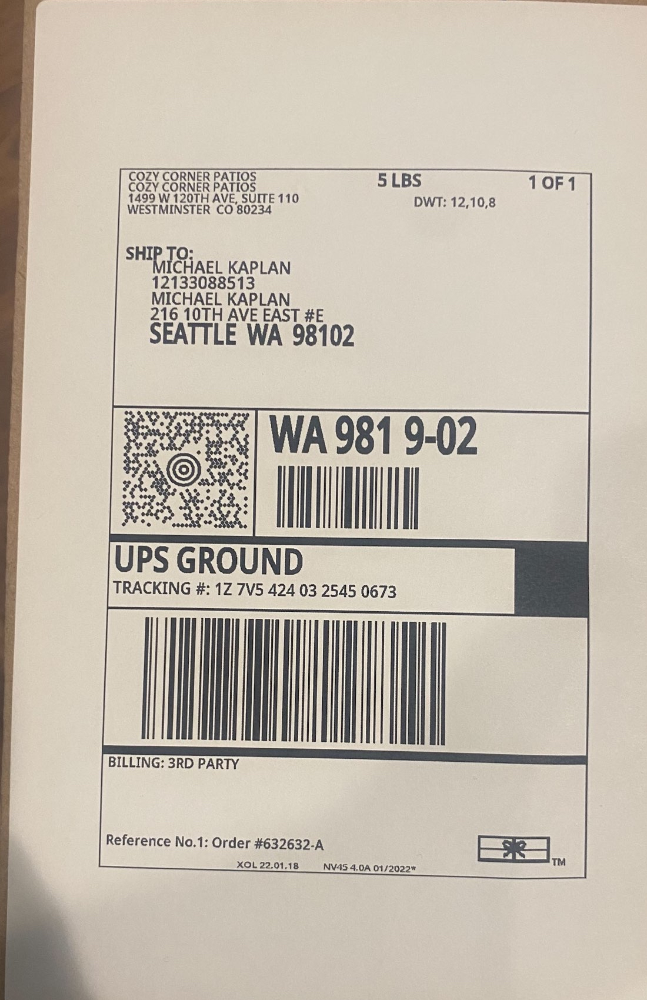

In [ ]:
from PIL import Image, ImageDraw, ImageFont

image = Image.open("/content/drive/MyDrive/new_image2.png")
image = image.convert("RGB")
image

In [ ]:
# let's create a dataset just for this image
inference_dataset = FUNSDDataset(image_file_names=["Image11.jpg_image_0.jpg"], tokenizer=tokenizer, max_length=512, target_size=224, train=False)
print(inference_dataset[0])
test_encoding = inference_dataset[0]
test_encoding.keys()

Image11.jpg_image_0.jpg
{'input_ids': tensor([  101, 26931,  3420, 19404,  2015, 26931,  3420, 19404,  2015, 17332,
         2683,  1059,  6036,  2705, 13642,  1010,  7621,  7287,  9434,  2522,
        23908, 22022, 10972,  7055, 16528, 16703, 21619,  2581, 21057,  2575,
        10972,  7055, 25621,  7663,  2497,  2346,  7797,  2821,  3429, 21926,
         2509,  2821,  3429,  2475,  1023,  1011,  5139, 11139,  2598,  9651,
         1001,  1024,  1015,  2480,  1021,  2615,  2629,  4413,  2549,  6021,
        20304,  2575,  5388, 22394,  4431,  2053,  1012,  1015,  1024,  2344,
         1001,  6191, 23833, 14142,  1011,  1037,   102,     0,     0,     0,
            0,     0,     0,     0,     0,     0,     0,     0,     0,     0,
            0,     0,     0,     0,     0,     0,     0,     0,     0,     0,
            0,     0,     0,     0,     0,     0,     0,     0,     0,     0,
            0,     0,     0,     0,     0,     0,     0,     0,     0,     0,
            0,     0,     

dict_keys(['input_ids', 'token_type_ids', 'attention_mask', 'bbox', 'labels', 'resized_image', 'resized_and_aligned_bounding_boxes', 'unnormalized_token_boxes'])

In [ ]:
for k,v in test_encoding.items():
  print(test_encoding[k].shape)
# print(test_encoding['labels'].shape)
# x[None, :]
test_encoding=inference_dataset[0]
print(input_ids.shape,test_encoding['input_ids'][None,:].shape)
print(bbox.shape,test_encoding['bbox'][None,:].shape)
print(attention_mask.shape,test_encoding['attention_mask'][None,:].shape)
print(token_type_ids.shape,test_encoding['token_type_ids'][None,:].shape)
print(labels.shape,test_encoding['labels'][None,:].shape)
print(resized_images.shape,test_encoding['resized_image'][None,:].shape)
print(resized_and_aligned_bounding_boxes.shape,test_encoding['resized_and_aligned_bounding_boxes'][None,:].shape)
# outputs = model(  resized_and_aligned_bounding_boxes=test_encoding['resized_and_aligned_bounding_boxes'])


torch.Size([512])
torch.Size([512])
torch.Size([512])
torch.Size([512, 4])
torch.Size([512])
torch.Size([3, 224, 224])
torch.Size([512, 4])
torch.Size([512, 4])
Image11.jpg_image_0.jpg
torch.Size([4, 512]) torch.Size([1, 512])
torch.Size([4, 512, 4]) torch.Size([1, 512, 4])
torch.Size([4, 512]) torch.Size([1, 512])
torch.Size([4, 512]) torch.Size([1, 512])
torch.Size([4, 512]) torch.Size([1, 512])
torch.Size([4, 3, 224, 224]) torch.Size([1, 3, 224, 224])
torch.Size([4, 512, 4]) torch.Size([1, 512, 4])


In [ ]:
# forward pass to get logits
print(test_encoding.keys())
outputs = model(input_ids=test_encoding['input_ids'][None,:].cuda(), bbox=test_encoding['bbox'][None,:].cuda(), attention_mask=test_encoding['attention_mask'][None,:].cuda(), token_type_ids=test_encoding['token_type_ids'][None,:].cuda(), labels=test_encoding['labels'][None,:].cuda(), resized_images=test_encoding['resized_image'][None,:].cuda(), resized_and_aligned_bounding_boxes=test_encoding['resized_and_aligned_bounding_boxes'][None,:].cuda())

dict_keys(['input_ids', 'token_type_ids', 'attention_mask', 'bbox', 'labels', 'resized_image', 'resized_and_aligned_bounding_boxes', 'unnormalized_token_boxes'])


In [ ]:
print(bbox.shape)
print(input_ids.shape)

torch.Size([4, 512, 4])
torch.Size([4, 512])


In [ ]:
print(output.shape)

In [ ]:
token_predictions = outputs.logits.argmax(-1).squeeze().tolist() # the predictions are at the token level
token_actual_boxes = test_encoding['unnormalized_token_boxes'].squeeze().tolist()
# print(token_actual_boxes)
word_level_predictions = [] # let's turn them into word level predictions
final_boxes = []
print(input_ids.shape,len(token_actual_boxes))
#print(input_ids.squeeze().tolist())
for id, token_pred, box in zip(test_encoding['input_ids'][None,:].squeeze().tolist(), token_predictions, token_actual_boxes):
  if (tokenizer.decode(id).startswith("##")) or (id in [tokenizer.cls_token_id, 
                                                           tokenizer.sep_token_id, 
                                                          tokenizer.pad_token_id]):
    # skip prediction + bounding box

    continue
  else:
    word_level_predictions.append(token_pred)
    final_boxes.append(box)

# print(word_level_predictions)
print(final_boxes)


torch.Size([4, 512]) 512
[[169, 270, 225, 291], [227, 270, 313, 292], [315, 270, 391, 291], [315, 270, 391, 291], [170, 289, 225, 309], [228, 289, 312, 309], [315, 288, 392, 309], [315, 288, 392, 309], [171, 308, 220, 328], [171, 308, 220, 328], [222, 308, 245, 327], [248, 308, 311, 327], [248, 308, 311, 327], [314, 307, 361, 329], [314, 307, 361, 329], [364, 308, 424, 328], [426, 309, 464, 329], [169, 325, 316, 348], [322, 326, 418, 347], [322, 326, 418, 347], [322, 326, 418, 347], [217, 420, 324, 448], [329, 420, 433, 448], [217, 446, 398, 474], [217, 446, 398, 474], [217, 446, 398, 474], [217, 446, 398, 474], [217, 446, 398, 474], [217, 446, 398, 474], [218, 474, 325, 500], [331, 474, 434, 501], [217, 501, 266, 527], [274, 501, 345, 526], [274, 501, 345, 526], [352, 500, 432, 527], [215, 526, 443, 567], [456, 526, 514, 567], [527, 526, 635, 568], [527, 526, 635, 568], [527, 526, 635, 568], [432, 679, 520, 745], [532, 677, 639, 744], [532, 677, 639, 744], [646, 675, 769, 742], [646, 

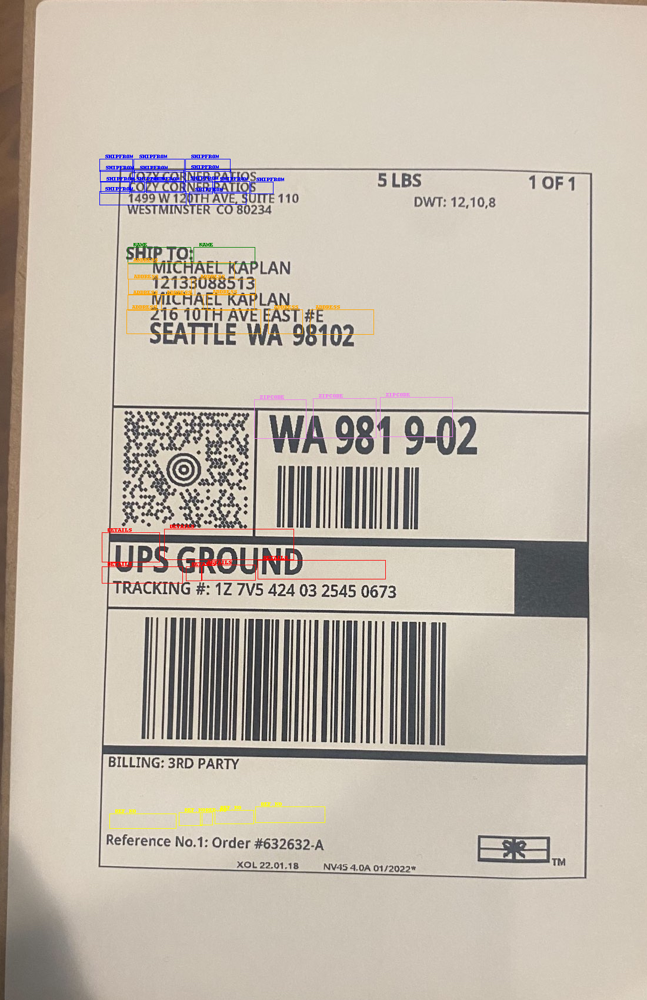

In [ ]:
draw = ImageDraw.Draw(image)

font = ImageFont.load_default()


def iob_to_label(label):
  if label != 'O':
    return label[2:]
  else:
    return "other"

# def iob_to_label(label):
#     return label[2:]

label2color = {'SHIPFROM':'blue', 'NAME':'green', 'ADDRESS':'orange', 'ZIPCODE':'violet', 'DETAILS':'red', 'REF.NO':'yellow'}

# for prediction, box in zip(word_level_predictions, final_boxes):
#     predicted_label = iob_to_label(label_map[prediction]).lower()
#     draw.rectangle(box, outline=label2color[predicted_label])
#     draw.text((box[0] + 10, box[1] - 10), text=predicted_label, fill=label2color[predicted_label], font=font)

image
for prediction, box in zip(word_level_predictions, final_boxes):
  predicted_label = iob_to_label(idx2label[prediction])
  draw.rectangle(box, outline=label2color[predicted_label])
  draw.text((box[0] + 10, box[1] - 10), text=predicted_label, fill=label2color[predicted_label], font=font)

image

In [ ]:
import cv2
from matplotlib import pyplot as plt
import numpy as np
import imutils
import easyocr
from pyzbar import pyzbar
from pyzbar.pyzbar import decode

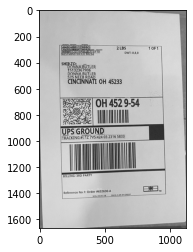

In [ ]:
img = cv2.imread('/content/Inference.png')
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
plt.imshow(cv2.cvtColor(gray, cv2.COLOR_BGR2RGB))

In [ ]:
bfilter = cv2.bilateralFilter(gray, 11, 17, 17)
edged = cv2.Canny(bfilter, 30, 200)
keypoints = cv2.findContours(edged.copy(), cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
contours = imutils.grab_contours(keypoints)
contours = sorted(contours, key=cv2.contourArea, reverse=True)[:10]
location = None
for contour in contours:
    approx = cv2.approxPolyDP(contour, 10, True)
    if len(approx) == 4:
        location = approx
        break
location

array([[[ 954,  995]],

       [[ 169, 1016]],

       [[ 174, 1243]],

       [[ 961, 1216]]], dtype=int32)

In [ ]:
mask = np.zeros(gray.shape, np.uint8)
new_image = cv2.drawContours(mask, [location], 0,1023, 1500)
new_image = cv2.bitwise_and(img, img, mask=mask)

In [ ]:
(x,y) = np.where(mask==255)
(x1, y1) = (np.min(x), np.min(y))
(x2, y2) = (np.max(x), np.max(y))
cropped_image = gray[x1:x2+1, y1:y2+1]

In [ ]:
reader = easyocr.Reader(['en'])
result = reader.readtext(cropped_image)
result

[([[180, 18], [222, 18], [222, 24], [180, 24]],
  'Mrddwadm',
  0.0033527797957338384),
 ([[236, 18], [284, 18], [284, 24], [236, 24]],
  'Garidwadmy',
  0.0035648570460514637),
 ([[176, 24], [394, 24], [394, 48], [176, 48]],
  'OTTKCORWERIRI',
  0.03197289261899177),
 ([[392, 56], [422, 56], [422, 62], [392, 62]], 'WaRMH', 0.02825000641025211),
 ([[434, 56], [484, 56], [484, 64], [434, 64]], 'SHPFROH', 0.9432209654334854),
 ([[589, 29], [671, 29], [671, 65], [589, 65]], '2 LBS', 0.9949124579803649),
 ([[832, 34], [916, 34], [916, 64], [832, 64]], '1 OF1', 0.9879840368291138),
 ([[255, 63], [309, 63], [309, 83], [255, 83]], 'POIH', 0.29078367352485657),
 ([[319, 63], [423, 63], [423, 83], [319, 83]],
  'AVEIQUIE',
  0.47330624096796753),
 ([[434, 62], [466, 62], [466, 86], [434, 86]], 'm', 0.8510268410140078),
 ([[650, 68], [764, 68], [764, 96], [650, 96]],
  'DWT: 8,8,8',
  0.6721105058163944),
 ([[168, 80], [316, 80], [316, 104], [168, 104]],
  'WESMNSLER',
  0.2604143248228907),
 ([

In [ ]:
print(result[0][1])
print(result[1][1])
print(result[2][1])
print(result[3][1])
print(result[4][1])
print(result[5][1])
print(result[6][1])
print(result[7][1])
print(result[8][1])
print(result[9][1])
print(result[10][1])
print(result[11][1])
print(result[12][1])
print(result[13][1])
print(result[14][1])
print(result[15][1])
print(result[16][1])

Mrddwadm
Garidwadmy
OTTKCORWERIRI
WaRMH
SHPFROH
2 LBS
1 OF1
POIH
AVEIQUIE
m
DWT: 8,8,8
WESMNSLER
CO80233
SHIRTO;
DONNABUTLER]
15132367906]
DONNA BUTLER
